In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from math import pi, inf
from sympy import limit
import time
from scipy.special import jv 
from itertools import product
import time
from scipy import real

In [2]:
dataMu1 = {"alpha" : 1/137, "c" : 1, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "theta1" : 0, "theta2" : pi,  "w" : 1}
dataMu1["delta"] = dataMu1["alpha"]*dataMu1["m1"]*dataMu1["m2"]*(dataMu1["theta1"] - dataMu1["theta2"])/pi
dataMu1["scale"] = (dataMu1["w"]/(2*pi*dataMu1["c"]))**(-1)
dataMu1["e2"] = 1
dataMu1["m2"] = 10**5
dataMu1["n2"] = 10**(5/2)
dataMu1["e3"] = 16
dataMu1["m3"] = 1
dataMu1["n3"] = 4
dataMu1["k1"] = dataMu1["n1"]*dataMu1["w"]/dataMu1["c"]
dataMu1["k2"] = dataMu1["n2"]*dataMu1["w"]/dataMu1["c"]
dataMu1["k3"] = dataMu1["n3"]*dataMu1["w"]/dataMu1["c"]
dataMu1["dist12"] = 1/6 #esto esta a escala 600nm (son 100nm - visto de un paper en donde trbajaban con thin films de 1000 Amstrong)
dataMu1["dist23"] = 0

dataMu2 = {"alpha" : 1/137, "c" : 1, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "theta1" : 0, "theta2" : pi,  "w" : 1}
dataMu2["e2"] = 1
dataMu2["m2"] = 16
dataMu2["n2"] = 4
dataMu2["e3"] = 1
dataMu2["m3"] = 10**5
dataMu2["n3"] = 10**(5/2)
dataMu2["k1"] = dataMu2["n1"]*dataMu2["w"]/dataMu2["c"]
dataMu2["k2"] = dataMu2["n2"]*dataMu2["w"]/dataMu2["c"]
dataMu2["k3"] = dataMu2["n3"]*dataMu2["w"]/dataMu2["c"]
dataMu2["delta"] = dataMu2["alpha"]*dataMu2["m1"]*dataMu2["m2"]*(dataMu2["theta1"] - dataMu2["theta2"])/pi
dataMu2["scale"] = (dataMu2["w"]/(2*pi*dataMu2["c"]))**(-1)
dataMu2["dist12"] = 1/6 #esto esta a escala 600nm (son 100nm - visto de un paper en donde trbajaban con thin films de 1000 Amstrong)
dataMu2["dist23"] = 0

dataMu3 = {"alpha" : 1/137, "c" : 1, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "theta1" : 0, "theta2" : 0,  "w" : 1}
dataMu3["e2"] = 1
dataMu3["m2"] = 16
dataMu3["n2"] = 4
dataMu3["e3"] = 1
dataMu3["m3"] = 10**5
dataMu3["n3"] = 10**(5/2)
dataMu3["k1"] = dataMu3["n1"]*dataMu3["w"]/dataMu3["c"]
dataMu3["k2"] = dataMu3["n2"]*dataMu3["w"]/dataMu3["c"]
dataMu3["k3"] = dataMu3["n3"]*dataMu3["w"]/dataMu3["c"]
dataMu3["delta"] = dataMu3["alpha"]*dataMu3["m1"]*dataMu3["m2"]*(dataMu3["theta1"] - dataMu3["theta2"])/pi
dataMu3["scale"] = (dataMu3["w"]/(2*pi*dataMu3["c"]))**(-1)
dataMu3["dist12"] = 1/6 #esto esta a escala 600nm (son 100nm - visto de un paper en donde trbajaban con thin films de 1000 Amstrong)
dataMu3["dist23"] = 0

In [3]:
def Rtmtm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
  thingy = ( (e2*np.sqrt(k1**2-kp**2)-e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)/( (e2*np.sqrt(k1**2-kp**2) + e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
  return thingy

def Rtetm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
  thingy = -2*m2*n1*np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta/( (e2*np.sqrt(k1**2-kp**2) + e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
  return thingy

def Rtete(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
  thingy = ( (m2*np.sqrt(k1**2-kp**2)-m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)/( (m2*np.sqrt(k1**2-kp**2) + m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
  return thingy

def Rtmte(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
  thingy = -2*m2*n1*np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta/( (m2*np.sqrt(k1**2-kp**2) + m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
  return thingy

def Ttmtm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
    thingy = n2/n1 * (2*e1*np.sqrt(k1**2-kp**2))*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2)))/ ( (e2*np.sqrt(k1**2-kp**2) + e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy
    
def Ttetm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
    return Rtetm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)

def Ttmte(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
    return -n2/n1*np.sqrt(k1**2-kp**2)/np.sqrt(k2**2-kp**2)*Rtmte(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)

def Ttete(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
    thingy = 1 + Rtete(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)
    return thingy

In [4]:
def ReflectiveMatrix(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
    return np.array([[Rtete(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c), Rtetm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)], [Rtmte(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c), Rtmtm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)]])

def TransmisiveMatrix(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c):
    return np.array([[Ttete(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c), Ttetm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)], [Ttmte(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c), Ttmtm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)]])

def VelocityMatrix(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23):
    r21 = ReflectiveMatrix(kp, e2, e1, k2, k1, m2, m1, n2, n1, -delta, c)
    r23 = ReflectiveMatrix(kp, e2, e3, k2, k3, m2, m3, n2, n3, -delta, c)
    return np.array([[1,0],[0,1]]) - np.e**(2j*np.sqrt(k2**2-kp**2)*(dist12-dist23))*r21 @ r23
def ThreeLayerReflexive(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs):
    r12 = ReflectiveMatrix(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)
    t21 = TransmisiveMatrix(kp, e2, e1, k2, k1, m2, m1, n2, n1, -delta, c)
    r23 = ReflectiveMatrix(kp, e2, e3, k2, k3, m2, m3, n2, n3, -delta, c)
    M = np.linalg.inv(VelocityMatrix(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23))
    t12 = TransmisiveMatrix(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c)
    M2 = t21 @ r23 @ M @ t12
    return  r12 + np.e**(-2j*np.sqrt(k2**2-kp**2)*(dist23-dist12)) * M2


def RteteMU(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs):
    return ThreeLayerReflexive(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs)[0,0]

def RtetmMU(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs):
    return ThreeLayerReflexive(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs)[0,1]

def RtmtmMU(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs):
    return ThreeLayerReflexive(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs)[1,1]

def RtmteMU(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs):
    return ThreeLayerReflexive(kp, e1, e2, e3, k1, k2, k3, m1, m2, m3, n1, n2, n3, delta, c, dist12, dist23, **kwargs)[1,0]


In [5]:
def GRzz_integrand(kp, x, y, z, zp, data=dataMu2):
    k1 = data["k1"]
    return np.imag((1j/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(0,kp*np.sqrt(x**2+y**2))*(kp**3/(k1**2*np.sqrt(k1**2-kp**2)))*RtmtmMU(kp, **data))

def GRyz_integrand(kp, x, y, z, zp, data=dataMu2):
    k1 = data["k1"]
    return np.imag((1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/(k1*np.sqrt(k1**2-kp**2)))*RtetmMU(kp, **data))

def GRxz_integrand(kp, x, y, z, zp, data=dataMu2):
    k1 = data["k1"]
    return np.imag((1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/k1)*RtmtmMU(kp, **data))

def GRxx_integrand(kp, x, y, z, zp, data=dataMu2):
    rtmtm = RtmtmMU(kp, **data)
    rtete = RteteMU(kp, **data)
    k1 = data["k1"]
    return np.imag((1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp/(np.sqrt(k1**2-kp**2)))*rtete - (jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp*np.sqrt(k1**2-kp**2)/k1**2)*rtmtm))

def GRyx_integrand(kp, x, y, z, zp, data=dataMu2):
    rtetm = RtetmMU(kp, **data)
    rtmte = RtmteMU(kp, **data)
    k1 = data["k1"]
    return np.imag((-1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtetm + (jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtmte))

def GRzx_integrand(kp, x, y, z, zp, data=dataMu2):
    rtmtm = RtmtmMU(kp, **data)
    k1 = data["k1"]
    return np.imag((-1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/k1**2)*rtmtm)

def GRyy_integrand(kp, x, y, z, zp, data=dataMu2):
    rtmtm = RtmtmMU(kp, **data)
    rtete = RteteMU(kp, **data)
    k1 = data["k1"]
    return np.imag((1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp/(np.sqrt(k1**2-kp**2)))*rtete - (jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp*np.sqrt(k1**2-kp**2)/k1**2)*rtmtm))

def GRxy_integrand(kp, x, y, z, zp, data=dataMu2):
    rtetm = RtetmMU(kp, **data)
    rtmte = RtmteMU(kp, **data)
    k1 = data["k1"]
    return np.imag((1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtetm + (jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtmte))

def GRzy_integrand(kp, x, y, z, zp, data=dataMu2):
    rtmte = RtmteMU(kp, **data)
    k1 = data["k1"]
    return np.imag((1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/(k1*np.sqrt(k1**2-kp**2)))*rtmte)


In [6]:
def G_xz(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRxz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_yz(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRyz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_zz(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_xx(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_yx(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRyx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_zx(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRzx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_xy(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRxy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_yy(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRyy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_zy(x, y, z, zp=1.5, data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRzy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

In [7]:
Gzz = np.vectorize(G_zz)
Gyz = np.vectorize(G_yz)
Gxz = np.vectorize(G_xz)
Gxx = np.vectorize(G_xx)
Gyx = np.vectorize(G_yx)
Gzx = np.vectorize(G_zx)
Gxy = np.vectorize(G_xy)
Gyy = np.vectorize(G_yy)
Gzy = np.vectorize(G_zy)

In [8]:
start = time.time()

x = np.arange(-2,2, 0.08)
y = [0]*len(x)
z = np.arange(0,3, 0.06)

x,z = np.meshgrid(x,z)

end = time.time()
print('elapsed time xyz product: {} seg'.format(end - start))

elapsed time xyz product: 0.0005197525024414062 seg


In [9]:
start = time.time()
Gzz_points1 = Gzz(x,0,z, data=dataMu2)
Gzz_points2 = Gzz(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gzz calculations: {} seg'.format(end - start))

start = time.time()
Gyz_points1 = Gyz(x,0,z, data=dataMu2)
Gyz_points2 = Gyz(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gyz calculations: {} seg'.format(end - start))

start = time.time()
Gxz_points1 = Gxz(x,0,z, data=dataMu2)
Gxz_points2 = Gxz(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gxz calculations: {} seg'.format(end - start))

start = time.time()
Gxx_points1 = Gxx(x,0,z, data=dataMu2)
Gxx_points2 = Gxx(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gxx calculations: {} seg'.format(end - start))

start = time.time()
Gyx_points1 = Gyx(x,0,z, data=dataMu2)
Gyx_points2 = Gyx(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gyx calculations: {} seg'.format(end - start))

start = time.time()
Gzx_points1 = Gzx(x,0,z, data=dataMu2)
Gzx_points2 = Gzx(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gzx calculations: {} seg'.format(end - start))

<ipython-input-6-c0f992f05290>:11: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
** elapsed time for Gzz calculations: 809.1435503959656 seg
** elapsed time for Gyz calculations: 184.72551465034485 seg
** elapsed time for Gxz calculations: 480.9374940395355 seg
<ipython-input-6-c0f992f05290>:15: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
** elapsed time for Gxx calculations: 1357.049217224121 seg
** elapsed time for Gyx calculations: 279.2127993106842 seg
** elapsed time for Gzx calculations: 478.62674951553345 seg


In [10]:
start = time.time()
Gxy_points1 = Gxy(x,0,z, data=dataMu2)
Gxy_points2 = Gxy(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gxy calculations: {} seg'.format(end - start))

start = time.time()
Gyy_points1 = Gyy(x,0,z, data=dataMu2)
Gyy_points2 = Gyy(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gyy calculations: {} seg'.format(end - start))

start = time.time()
Gzy_points1 = Gzy(x,0,z, data=dataMu2)
Gzy_points2 = Gzy(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gzy calculations: {} seg'.format(end - start))

** elapsed time for Gxy calculations: 280.3580331802368 seg
<ipython-input-6-c0f992f05290>:31: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRyy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
** elapsed time for Gyy calculations: 1406.6488676071167 seg
** elapsed time for Gzy calculations: 184.10254287719727 seg


In [11]:
#G0
def G0(x,y,z,zp=1.5,xp=0,yp=0,data=dataMu2):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    w = data['w']
    k = data['k1']
    R = np.sqrt((x-xp)**2+(y-yp)**2+(z-zp)**2)
    Id = np.array([[1,0,0],[0,1,0],[0,0,1]])
    Rv = np.array([x-xp,y-yp,z-zp])
    thing = np.e**(1j*k*R)/(4*pi*R)*((1 + (1j*k*R-1)/(k**2*R**2))*Id+ (3-3j*k*R-k**2*R**2)/(k**2*R**4)*np.outer(Rv,Rv))
    return thing

def G0_xx(x,y,z,zp=1.5,data=dataMu2):
    thing = np.imag(G0(x,y,z,zp=zp,data=data)[0,0])
    if abs(thing) >= 10: return 0
    return thing

def G0_yx(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[1,0])

def G0_zx(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[2,0])

def G0_xy(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[0,1])

def G0_yy(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[1,1])

def G0_zy(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[2,1])

def G0_xz(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[0,2])

def G0_yz(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[1,2])

def G0_zz(x,y,z,zp=1.5,data=dataMu2):
    return np.imag(G0(x,y,z,zp=zp,data=data)[2,2])

In [12]:
G0zz = np.vectorize(G0_zz)
G0yz = np.vectorize(G0_yz)
G0xz = np.vectorize(G0_xz)
G0xx = np.vectorize(G0_xx)
G0yx = np.vectorize(G0_yx)
G0zx = np.vectorize(G0_zx)
G0xy = np.vectorize(G0_xy)
G0yy = np.vectorize(G0_yy)
G0zy = np.vectorize(G0_zy)

In [13]:
start = time.time()

x = np.arange(-2,2, 0.08)
y = [0]*len(x)
z = np.arange(0,3, 0.06)

x,z = np.meshgrid(x,z)

end = time.time()
print('elapsed time xyz product: {} seg'.format(end - start))

start = time.time()
G0zz_points1 = G0zz(x,0,z, data=dataMu2)
G0zz_points2 = G0zz(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gzz calculations: {} seg'.format(end - start))

start = time.time()
G0yz_points1 = G0yz(x,0,z, data=dataMu2)
G0yz_points2 = G0yz(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gyz calculations: {} seg'.format(end - start))

start = time.time()
G0xz_points1 = G0xz(x,0,z, data=dataMu2)
G0xz_points2 = G0xz(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gxz calculations: {} seg'.format(end - start))

start = time.time()
G0xx_points1 = G0xx(x,0,z, data=dataMu2)
G0xx_points2 = G0xx(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gxx calculations: {} seg'.format(end - start))

start = time.time()
G0yx_points1 = G0yx(x,0,z, data=dataMu2)
G0yx_points2 = G0yx(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gyx calculations: {} seg'.format(end - start))

start = time.time()
G0zx_points1 = G0zx(x,0,z, data=dataMu2)
G0zx_points2 = G0zx(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gzx calculations: {} seg'.format(end - start))

start = time.time()
G0xy_points1 = G0xy(x,0,z, data=dataMu2)
G0xy_points2 = G0xy(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gxy calculations: {} seg'.format(end - start))

start = time.time()
G0yy_points1 = G0yy(x,0,z, data=dataMu2)
G0yy_points2 = G0yy(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gyy calculations: {} seg'.format(end - start))

start = time.time()
G0zy_points1 = G0zy(x,0,z, data=dataMu2)
G0zy_points2 = G0zy(x,0,z, data=dataMu3)
end = time.time()
print('** elapsed time for Gzy calculations: {} seg'.format(end - start))

elapsed time xyz product: 0.0 seg
** elapsed time for Gzz calculations: 0.10802483558654785 seg
** elapsed time for Gyz calculations: 0.10102272033691406 seg
** elapsed time for Gxz calculations: 0.09902215003967285 seg
** elapsed time for Gxx calculations: 0.1000220775604248 seg
** elapsed time for Gyx calculations: 0.09902238845825195 seg
** elapsed time for Gzx calculations: 0.09902286529541016 seg
** elapsed time for Gxy calculations: 0.10002255439758301 seg
** elapsed time for Gyy calculations: 0.10002279281616211 seg
** elapsed time for Gzy calculations: 0.10002279281616211 seg


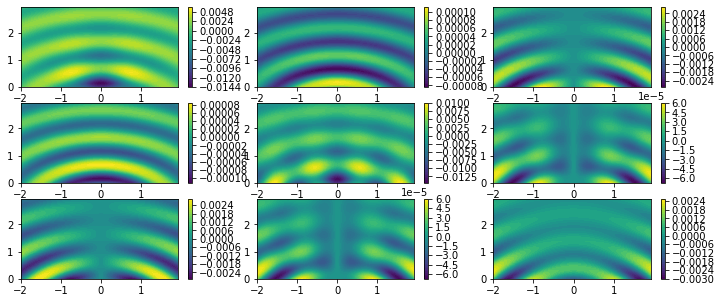

In [14]:
fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, Gxx_points1, 50)
cs01 = axs[0,1].contourf(x, z, Gyx_points1, 50)
cs02 = axs[0,2].contourf(x, z, Gzx_points1, 50)
cs10 = axs[1,0].contourf(x, z, Gxy_points1, 50)
cs11 = axs[1,1].contourf(x, z, Gyy_points1, 50)
cs12 = axs[1,2].contourf(x, z, Gzy_points1, 50)
cs20 = axs[2,0].contourf(x, z, Gxz_points1, 50)
cs21 = axs[2,1].contourf(x, z, Gyz_points1, 50)
cs22 = axs[2,2].contourf(x, z, Gzz_points1, 50)

fig.colorbar(cs00, ax=axs[0,0])
fig.colorbar(cs01, ax=axs[0,1])
fig.colorbar(cs02, ax=axs[0,2])
fig.colorbar(cs10, ax=axs[1,0])
fig.colorbar(cs11, ax=axs[1,1])
fig.colorbar(cs12, ax=axs[1,2])
fig.colorbar(cs20, ax=axs[2,0])
fig.colorbar(cs21, ax=axs[2,1])
fig.colorbar(cs22, ax=axs[2,2])

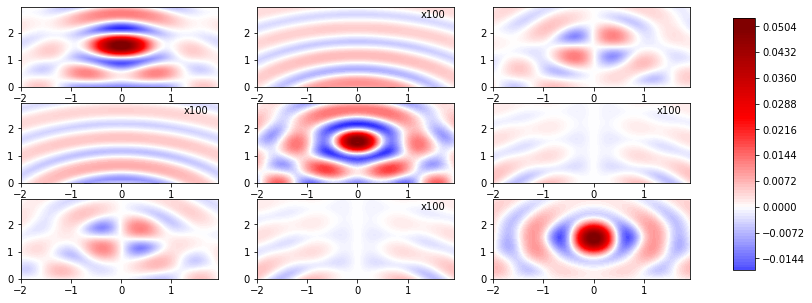

In [33]:
our_cmap = 'seismic'

fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, Gxx_points1 + G0xx_points1, 1000, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs01 = axs[0,1].contourf(x, z, Gyx_points1*100 + G0yx_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs02 = axs[0,2].contourf(x, z, Gzx_points1 + G0zx_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs10 = axs[1,0].contourf(x, z, Gxy_points1*100 + G0xy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs11 = axs[1,1].contourf(x, z, Gyy_points1 + G0yy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs12 = axs[1,2].contourf(x, z, Gzy_points1*100 + G0zy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs20 = axs[2,0].contourf(x, z, Gxz_points1 + G0xz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs21 = axs[2,1].contourf(x, z, Gyz_points1*100 + G0yz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs22 = axs[2,2].contourf(x, z, Gzz_points1 + G0zz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)

# fig.colorbar(cs00, ax=axs[0,0])
# fig.colorbar(cs01, ax=axs[0,1])
# fig.colorbar(cs02, ax=axs[0,2])
# fig.colorbar(cs10, ax=axs[1,0])
# fig.colorbar(cs11, ax=axs[1,1])
# fig.colorbar(cs12, ax=axs[1,2])
# fig.colorbar(cs20, ax=axs[2,0])
# fig.colorbar(cs21, ax=axs[2,1])
# fig.colorbar(cs22, ax=axs[2,2])

css = [cs00, cs01, cs02, cs10, cs11, cs12, cs20, cs21, cs22] 
css1000 = [(0,1), (1,0), (1,2), (2,1)]
for csij in css:
    for c in csij.collections:
        c.set_edgecolor("face")

for i,j in css1000: 
    axs[i,j].annotate('x100', (0.83,0.86), xycoords='axes fraction')

fig.colorbar(cs22, cax=fig.add_axes([0.95, 0.15, 0.025, 0.7]))

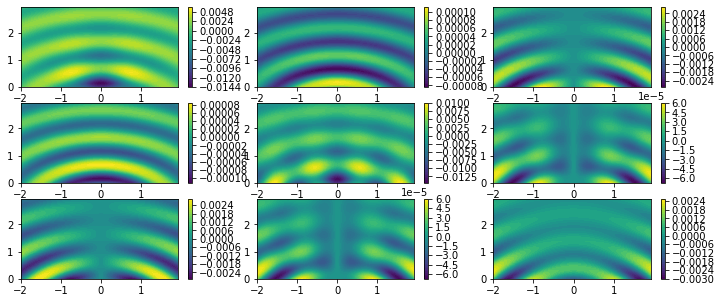

In [13]:
fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, Gxx_points2, 50)
cs01 = axs[0,1].contourf(x, z, Gyx_points2, 50)
cs02 = axs[0,2].contourf(x, z, Gzx_points2, 50)
cs10 = axs[1,0].contourf(x, z, Gxy_points2, 50)
cs11 = axs[1,1].contourf(x, z, Gyy_points2, 50)
cs12 = axs[1,2].contourf(x, z, Gzy_points2, 50)
cs20 = axs[2,0].contourf(x, z, Gxz_points2, 50)
cs21 = axs[2,1].contourf(x, z, Gyz_points2, 50)
cs22 = axs[2,2].contourf(x, z, Gzz_points2, 50)

fig.colorbar(cs00, ax=axs[0,0])
fig.colorbar(cs01, ax=axs[0,1])
fig.colorbar(cs02, ax=axs[0,2])
fig.colorbar(cs10, ax=axs[1,0])
fig.colorbar(cs11, ax=axs[1,1])
fig.colorbar(cs12, ax=axs[1,2])
fig.colorbar(cs20, ax=axs[2,0])
fig.colorbar(cs21, ax=axs[2,1])
fig.colorbar(cs22, ax=axs[2,2])

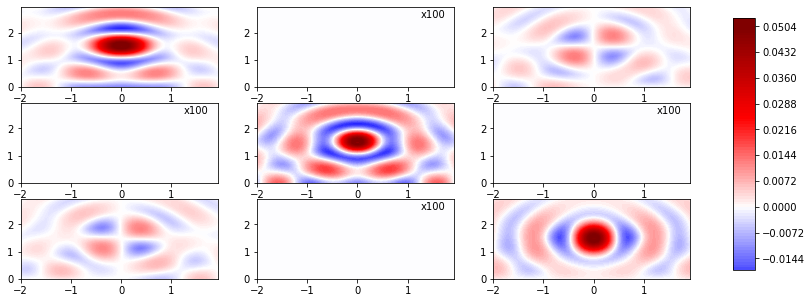

In [35]:
our_cmap = 'seismic'

fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, Gxx_points2 + G0xx_points2, 1000, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs01 = axs[0,1].contourf(x, z, Gyx_points2*100 + G0yx_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs02 = axs[0,2].contourf(x, z, Gzx_points2 + G0zx_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs10 = axs[1,0].contourf(x, z, Gxy_points2*100 + G0xy_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs11 = axs[1,1].contourf(x, z, Gyy_points2 + G0yy_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs12 = axs[1,2].contourf(x, z, Gzy_points2*100 + G0zy_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs20 = axs[2,0].contourf(x, z, Gxz_points2 + G0xz_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs21 = axs[2,1].contourf(x, z, Gyz_points2*100 + G0yz_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs22 = axs[2,2].contourf(x, z, Gzz_points2 + G0zz_points2, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)

# fig.colorbar(cs00, ax=axs[0,0])
# fig.colorbar(cs01, ax=axs[0,1])
# fig.colorbar(cs02, ax=axs[0,2])
# fig.colorbar(cs10, ax=axs[1,0])
# fig.colorbar(cs11, ax=axs[1,1])
# fig.colorbar(cs12, ax=axs[1,2])
# fig.colorbar(cs20, ax=axs[2,0])
# fig.colorbar(cs21, ax=axs[2,1])
# fig.colorbar(cs22, ax=axs[2,2])

css = [cs00, cs01, cs02, cs10, cs11, cs12, cs20, cs21, cs22] 
css1000 = [(0,1), (1,0), (1,2), (2,1)]
for csij in css:
    for c in csij.collections:
        c.set_edgecolor("face")

for i,j in css1000: 
    axs[i,j].annotate('x100', (0.83,0.86), xycoords='axes fraction')


fig.colorbar(cs22, cax=fig.add_axes([0.95, 0.15, 0.025, 0.7]))

In [26]:
# Emission Rate 
def rho_xz(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gxz(x,y,z,z,data)

def rho_yz(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gyz(x,y,z,z,data)

def rho_zz(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gzz(x,y,z,z,data)

def rho_xx(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gxx(x,y,z,z,data)

def rho_yx(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gyx(x,y,z,z,data)

def rho_zx(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gzx(x,y,z,z,data)

def rho_xy(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gxy(x,y,z,z,data)

def rho_yy(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gyy(x,y,z,z,data)

def rho_zy(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n2']**2/data['w'])*Gzy(x,y,z,z,data)

In [27]:
start = time.time()
rhozz_points1 = rho_zz(x,0,z, data=dataMu1)
rhozz_points2 = rho_zz(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho zz calculations: {} seg'.format(end - start))

start = time.time()
rhoyz_points1 = rho_yz(x,0,z, data=dataMu1)
rhoyz_points2 = rho_yz(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho yz calculations: {} seg'.format(end - start))

start = time.time()
rhoxz_points1 = rho_xz(x,0,z, data=dataMu1)
rhoxz_points2 = rho_xz(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho xz calculations: {} seg'.format(end - start))

start = time.time()
rhozx_points1 = rho_zx(x,0,z, data=dataMu1)
rhozx_points2 = rho_zx(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho xx calculations: {} seg'.format(end - start))

start = time.time()
rhoyx_points1 = rho_yx(x,0,z, data=dataMu1)
rhoyx_points2 = rho_yx(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho yx calculations: {} seg'.format(end - start))

start = time.time()
rhoxx_points1 = rho_xx(x,0,z, data=dataMu1)
rhoxx_points2 = rho_xx(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho zx calculations: {} seg'.format(end - start))

ValueError: operands could not be broadcast together with shapes (200,) () (50,50) (50,50) () 

In [ ]:
start = time.time()
rhozy_points1 = rho_zy(x,0,z, data=dataMu1)
rhozy_points2 = rho_zy(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho zy calculations: {} seg'.format(end - start))

start = time.time()
rhoyy_points1 = rho_yy(x,0,z, data=dataMu1)
rhoyy_points2 = rho_yy(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho yy calculations: {} seg'.format(end - start))

start = time.time()
rhoxy_points1 = rho_xy(x,0,z, data=dataMu1)
rhoxy_points2 = rho_xy(x,0,z, data=dataMu2)
end = time.time()
print('** elapsed time for Rho xy calculations: {} seg'.format(end - start))

In [ ]:
fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, rhoxx_points1, 50)
cs01 = axs[0,1].contourf(x, z, rhoyx_points1, 50)
cs02 = axs[0,2].contourf(x, z, rhozx_points1, 50)
cs10 = axs[1,0].contourf(x, z, rhoxy_points1, 50)
cs11 = axs[1,1].contourf(x, z, rhoyy_points1, 50)
cs12 = axs[1,2].contourf(x, z, rhozy_points1, 50)
cs20 = axs[2,0].contourf(x, z, rhoxz_points1, 50)
cs21 = axs[2,1].contourf(x, z, rhoyz_points1, 50)
cs22 = axs[2,2].contourf(x, z, rhozz_points1, 50)

fig.colorbar(cs00, ax=axs[0,0])
fig.colorbar(cs01, ax=axs[0,1])
fig.colorbar(cs02, ax=axs[0,2])
fig.colorbar(cs10, ax=axs[1,0])
fig.colorbar(cs11, ax=axs[1,1])
fig.colorbar(cs12, ax=axs[1,2])
fig.colorbar(cs20, ax=axs[2,0])
fig.colorbar(cs21, ax=axs[2,1])
fig.colorbar(cs22, ax=axs[2,2])

In [ ]:
fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, rhoxx_points2, 50)
cs01 = axs[0,1].contourf(x, z, rhoyx_points2, 50)
cs02 = axs[0,2].contourf(x, z, rhozx_points2, 50)
cs10 = axs[1,0].contourf(x, z, rhoxy_points2, 50)
cs11 = axs[1,1].contourf(x, z, rhoyy_points2, 50)
cs12 = axs[1,2].contourf(x, z, rhozy_points2, 50)
cs20 = axs[2,0].contourf(x, z, rhoxz_points2, 50)
cs21 = axs[2,1].contourf(x, z, rhoyz_points2, 50)
cs22 = axs[2,2].contourf(x, z, rhozz_points2, 50)

fig.colorbar(cs00, ax=axs[0,0])
fig.colorbar(cs01, ax=axs[0,1])
fig.colorbar(cs02, ax=axs[0,2])
fig.colorbar(cs10, ax=axs[1,0])
fig.colorbar(cs11, ax=axs[1,1])
fig.colorbar(cs12, ax=axs[1,2])
fig.colorbar(cs20, ax=axs[2,0])
fig.colorbar(cs21, ax=axs[2,1])
fig.colorbar(cs22, ax=axs[2,2])

In [ ]:
data_lifetime = {"alpha" : 1/137, "c" : 299792458, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "n2" : 1.65, "theta1" : 0, "theta2" : pi,  "w" : 1}
# data_lifetime['m2'] = data_lifetime['m1']*(np.sqrt(0.48**2+17.3**2)*4*pi*10**(-7) + 1)
# data_lifetime['alpha'] = (1.60218*10**(-19))**2/(4*pi)
data_lifetime['e2'] = 0.48
data_lifetime["m2"] = (data_lifetime['n2']**2)/data_lifetime['e2']
data_lifetime['w'] = 2*pi*data_lifetime['c']/(600*10**(-9))
data_lifetime["delta"] = data_lifetime["alpha"]*data_lifetime["m1"]*data_lifetime["m2"]*(data_lifetime["theta1"] - data_lifetime["theta2"])/pi
data_lifetime["scale"] = (600*10**(-9)/(2*pi*data_lifetime["c"]))**(-1)
data_lifetime["k1"] = data_lifetime["n1"]*data_lifetime["w"]/data_lifetime["c"]
data_lifetime["k2"] = data_lifetime["n2"]*data_lifetime["w"]/data_lifetime["c"]

In [ ]:
#LDOS y Lifetime 
def ldos(x, y, z, data=data1):
    return 1 + ((2*pi*data['c']*data['n2']**2)/(data['w']))*(Gxx(x,y,z,z,data)+Gyy(x,y,z,z,data)+Gzz(x,y,z,z,data))

def lifetime(x, y, z, data=data1, t_inf=1, eta=0.61):
    # z=z*10**(-9)
    return t_inf/(1 + eta*(ldos(x, y, z, data) - 1))

In [ ]:
zl = np.arange(0, 2, 0.01)

start = time.time()
lifetime_points1 = lifetime(0,0,zl, data=data1)
end = time.time()
print('** elapsed time for lifetime calculations: {} seg'.format(end - start))

In [ ]:
fig, ax = plt.subplots()
ax.plot(zl*600, lifetime_points1)

In [ ]:
def pldos_perp(x, y, z, data=data1):
    return 1 + ((6*pi*data['c']*data['n2']**2)/(data['w']))*(Gzz(x,y,z,z,data))

def pldos_paral(x, y, z, data=data1):
    return 1 + ((3*pi*data['c']*data['n2']**2)/(data['w']))*(Gxx(x,y,z,z,data)+Gyy(x,y,z,z,data))

In [ ]:
start = time.time()

x = np.arange(0,2, 0.01)
y_perp = pldos_perp(0, 0, x)
y_parall = pldos_paral(0, 0, x)
y_ldos = ldos(0, 0, x)

# %%
fig, ax = plt.subplots()
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

base_line, = ax.plot(x, [1 for z in x], linestyle='--', color= 'black')
perp, = ax.plot(x, y_perp, label=r'$3\rho_p(\perp)/\rho_0$', color= 'red') 
parall, = ax.plot(x, y_parall, label=r'$3\rho_p(||)/\rho_0$', color= 'blue')
gldos, = ax.plot(x, y_ldos, linestyle='--', label=r'$\rho_L/\rho_0$', color= 'green')

ax.legend(handles=[perp, parall, gldos], prop={'size': 10})
ax.set_xlabel(r'$z_0/\lambda$')
ax.set_ylabel(r'$3\rho_p/\rho_0$')
plt.show()

end = time.time()
print('elapsed time: {} seg'.format(end - start))

In [ ]:
start = time.time()

x = np.arange(0,2, 0.01)
y_perp = pldos_perp(0, 0, x, data=data2)
y_parall = pldos_paral(0, 0, x, data=data2)
y_ldos = ldos(0, 0, x, data=data2)

# %%
fig, ax = plt.subplots()
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

base_line, = ax.plot(x, [1 for z in x], linestyle='--', color= 'black')
perp, = ax.plot(x, y_perp, label=r'$3\rho_p(\perp)/\rho_0$', color= 'red') 
parall, = ax.plot(x, y_parall, label=r'$3\rho_p(||)/\rho_0$', color= 'blue')
gldos, = ax.plot(x, y_ldos, linestyle='--', label=r'$\rho_L/\rho_0$', color= 'green')

ax.legend(handles=[perp, parall, gldos], prop={'size': 10})
ax.set_xlabel(r'$z_0/\lambda$')
ax.set_ylabel(r'$3\rho_p/\rho_0$')
plt.show()

end = time.time()
print('elapsed time: {} seg'.format(end - start))